# Lab Work #2
### Nedozhdii Oleksii FF-31mn

In [2]:
import pandas as pd
import numpy as np

import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

In [3]:
df = pd.read_csv("resources/user_behavior_dataset.csv")

In [4]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
for col in ["Gender", "Device Model", "Operating System"]:
    df[col] = le.fit_transform(df[col])
target = "User Behavior Class"
features = df.columns.drop(labels=target)

In [5]:
from sklearn.preprocessing import  StandardScaler

scaler = StandardScaler()
features_std = pd.DataFrame(scaler.fit_transform(df[features]), columns=features)
X_std, y = features_std, df[target]

#### 1. Зниження розмірності і візуалізація даних

Застосуйте методи зниження розмірності sklearn.decomposition.PCA і sklearn.manifold.TSNE для візуалізації даних, з якими ви працювали в лабораторній № 1 (знижуючи розмірність до двох). Візуалізуйте результат.

In [6]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [7]:
pca = PCA()
X_pca = pca.fit_transform(X_std)
exp_var_pca = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
x = list(range(0, len(exp_var_pca)))

In [8]:
fig = make_subplots(rows=2,cols=1,
        shared_xaxes=True,
        vertical_spacing=0.01
)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),
        xaxis2=dict(title="Principal component",
                    showgrid=True,))

step_trace = go.Scatter(x=x, y=cum_sum_eigenvalues,
                        name="Cumulative<br>explained variance",
                        mode="lines", line_shape="hv")
bar_trace = go.Bar(x=x, y=exp_var_pca,
                        name="Explained variance")

fig.add_trace(step_trace, row=1, col=1)
fig.add_trace(bar_trace, row=2, col=1)
iplot(fig)

In [9]:
df_pca = pd.DataFrame({"PCA 1": X_pca[:,0],
                       "PCA 2": X_pca[:,1],
                       target: y})
df_pca[target] = df_pca[target].astype("category")
fig = px.scatter(df_pca, x="PCA 1", y="PCA 2",
                 color=target)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
iplot(fig)

In [10]:
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(X_std)

In [11]:
df_tsne = pd.DataFrame({"t-SNE 1": X_tsne[:,0], "t-SNE 2": X_tsne[:,1], target: y})
df_tsne[target] = df_tsne[target].astype("category")
fig = px.scatter(df_tsne, x="t-SNE 1", y="t-SNE 2", color=target)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
iplot(fig)

#### 2. Кластерний аналіз

За допомогою алгоритму k-means зробіть квантування зображення (видалення візуально надлишкової інформації) з глибиною 64, 32, 16 та 8 рівнів для будь-якого обраного самостійно зображення.

In [12]:
from sklearn.cluster import KMeans
from skimage import io

In [13]:
image = io.imread("resources/pic2.jpg")

In [56]:
def quantize_image(image, depth: int):
    image = np.array(image, dtype=np.float64) / 255
    w, h, d = image.shape
    image_array = image.reshape((w * h, d))
    kmeans = KMeans(n_clusters=depth, random_state=42).fit(image_array)
    labels = kmeans.predict(image_array)
    quantized_image = kmeans.cluster_centers_[labels].reshape(w, h, d)
    fig = trace_quantized = px.imshow(quantized_image)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    fig.update_xaxes(title=f"{depth} quantize level", showticklabels=False)
    fig.update_yaxes(showticklabels=False)
    iplot(fig)

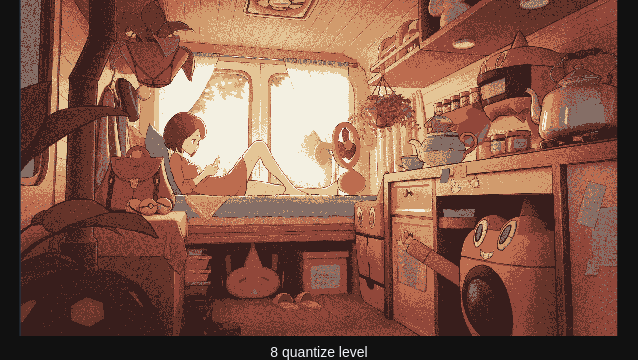

In [57]:
quantize_image(image, 8)

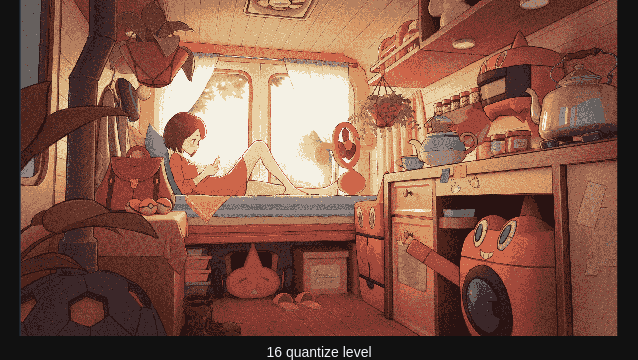

In [58]:
quantize_image(image, 16)

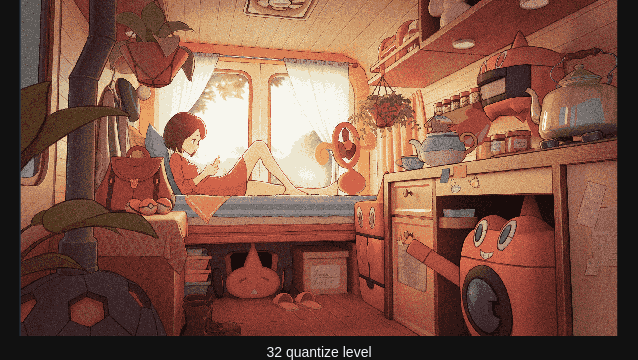

In [59]:
quantize_image(image, 32)

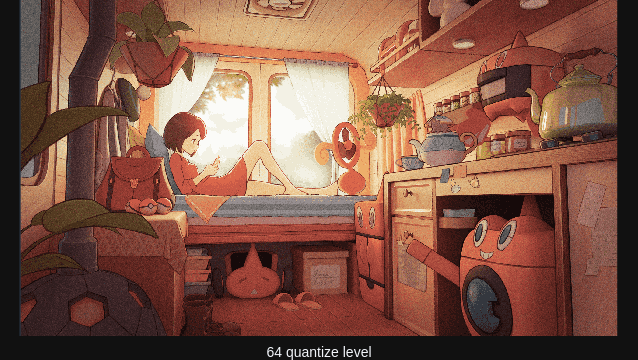

In [60]:
quantize_image(image, 64)

#### 3. Обробка та класифікація текстових даних

Завантажте набір текстових даних (з мітками класів). Проведіть передобробку даних (видаліть стоп-слова, пунктуацію), за допомогою wordcloud зробіть візуалізацію найбільш поширених слів або n-gram у кожному класі. Векторизуйте тексти (наприклад за допомогою sklearn.feature_extraction.text.TfidfVectorizer). Проведіть класифікацію текстових даних, зробіть оцінку якості.

**Dataset**

https://archive.ics.uci.edu/dataset/456/multimodal+damage+identification+for+humanitarian+computing

5879 text from social media related to damage during natural disasters/wars, and belong to 6 classes: Fires, Floods, Natural landscape, Infrastructural, Human, Non-damage.

In [19]:
import os
from itertools import chain

In [20]:
path = "resources/multimodal"
classes = os.listdir(path)
print(classes)
text_pathes = []
for class_dir in classes:
    class_path = os.path.join(path, class_dir)
    text_pathes.append(
            [os.path.join(class_path, file_name) for file_name in os.listdir(class_path)]
    )
class_column = []
for class_, text_pathes_per_class  in zip(classes, text_pathes):
    class_column.append([class_] * len(text_pathes_per_class))
class_column = list(chain.from_iterable(class_column))
text_path_column = list(chain.from_iterable(text_pathes))

df = pd.DataFrame({"file_path": text_path_column, "class": class_column})

['non_damage', 'damaged_infrastructure', 'fires', 'damaged_nature', 'human_damage', 'flood']


In [21]:
import string
import re

import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

In [22]:
nltk.download("stopwords")
nltk.download("punkt_tab")

[nltk_data] Error loading stopwords: <urlopen error [Errno -3]
[nltk_data]     Temporary failure in name resolution>
[nltk_data] Error loading punkt_tab: <urlopen error [Errno -3]
[nltk_data]     Temporary failure in name resolution>


False

In [23]:
text_column = []
for file_path in df["file_path"]:
    with open(file_path) as f: text_column.append(f.read())
df["raw_text"] = text_column

In [24]:
formated_text_column = []
stop_words = stopwords.words("english")
for raw_text in df["raw_text"]:
    formated_text = raw_text.lower()
    formated_text = re.sub(r"@\S+", " ", formated_text) # remove mentions
    formated_text = re.sub(r"https*\S+", " ", formated_text) # remove url
    formated_text = re.sub(r"#\S+", " ", formated_text) # remove hashtags
    formated_text = re.sub(r"\d", " ", formated_text) # remove all numbers
    formated_text = re.sub(r"[%s]" % re.escape(string.punctuation), ' ', formated_text) # remove punctuations
    formated_text = re.sub(r"\s{2,}", " ", formated_text) # remove extra spaces
    formated_text = re.sub(r'[^\x00-\x7F]+', '', formated_text) # remove not ascii
    formated_text = formated_text.strip()
    formated_text = ' '.join([word for word in formated_text.split(' ') if word not in stop_words])
    formated_text_column.append(formated_text)
df["formated_text"] = formated_text_column
df = df.query("`formated_text` != ''").reset_index(drop=True)

In [25]:
i = np.random.randint(len(df))
print("=============File path==============")
print(df.loc[i, "file_path"], end="\n\n")
print("=============Raw text===============")
print(df.loc[i, "raw_text"], end="\n\n")
print("=============Formated text==========")
print(df.loc[i, "formated_text"], end="\n\n")

=============File path==============
resources/multimodal/human_damage/yemencrisis_2016-03-04_23-31-11.txt

=============Raw text===============
Why's the selling weapons to when they kill civilians in Yemen
#usa_kills_yemeni_people 
#YemenCrisis #Yemenchildren #Saudi_war_crimes #Yemen #europe #saudiarabia #french  #yemenforgottenwar 
#اليمن_مقبره_الغزاه #صنعاء #Children #اليمن

=============Formated text==========
selling weapons kill civilians yemen



In [26]:
concated_text_per_class = {}
for class_ in df["class"].unique():
    text = ""
    for t in df.query(f"`class` == '{class_}'")["formated_text"]:
        text += t
    concated_text_per_class[class_] = text

In [27]:
from wordcloud import WordCloud

In [28]:
for i, class_ in enumerate(df["class"].unique()):
    wordcloud = WordCloud(
        # background_color="#F9F9FA",
        collocations=True,
        max_words=30,
    ).generate(concated_text_per_class[class_])
    fig = px.imshow(wordcloud)
    fig.update_xaxes(showticklabels=False, showgrid=False, automargin=True)
    fig.update_yaxes(showticklabels=False, showgrid=False, automargin=True)
    fig.update_layout(autosize=True, title=class_)
    iplot(fig)

In [29]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

### Naive Bayes Classifier

For text classsictaion Multinomial NB or Complement NB
- dataset balanced →  Multinomial NB
- dataset unbalanced → Complement NB

In [30]:
fig = px.histogram(df, x="class", title="Unbalanced")
iplot(fig)

In [31]:
from sklearn.naive_bayes import ComplementNB
from sklearn.metrics import classification_report, confusion_matrix

In [32]:
encoder = LabelEncoder()
df["class_num"] = encoder.fit_transform(df["class"])

In [33]:
X, y = df["formated_text"], df["class_num"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(f"{X_train.shape=}")
print(f"{X_test.shape=}")

X_train.shape=(3716,)
X_test.shape=(929,)


In [34]:
tfidf_vectorizer = TfidfVectorizer(use_idf=True, min_df=5)
tfidf_train = tfidf_vectorizer.fit_transform(X_train)
tfidf_test = tfidf_vectorizer.transform(X_test)

In [35]:
count_vectorizer = CountVectorizer(min_df=5)
count_train = count_vectorizer.fit_transform(X_train)
count_test = count_vectorizer.transform(X_test)

In [42]:
clf_tfidf = ComplementNB(alpha=0.6)
clf_tfidf.fit(tfidf_train, y_train)

ComplementNB(alpha=0.6)

In [43]:
clf_count = ComplementNB(alpha=0.6)
clf_count.fit(count_train, y_train)

ComplementNB(alpha=0.6)

In [38]:
y_pred_tfidf = clf_tfidf.predict(tfidf_test)
print(classification_report(y_test, y_pred_tfidf))

              precision    recall  f1-score   support

           0       0.53      0.68      0.60       182
           1       0.54      0.42      0.47        96
           2       0.60      0.71      0.65        52
           3       0.57      0.43      0.49        76
           4       0.69      0.87      0.77        39
           5       0.85      0.79      0.82       484

    accuracy                           0.70       929
   macro avg       0.63      0.65      0.63       929
weighted avg       0.71      0.70      0.70       929



In [39]:
conf_matrix = confusion_matrix(y_test, y_pred_tfidf, normalize="all")
print(conf_matrix)

[[0.13347686 0.00968784 0.00430571 0.00861141 0.00322928 0.03659849]
 [0.02152853 0.04305705 0.00430571 0.01076426 0.00215285 0.02152853]
 [0.00968784 0.00107643 0.03982777 0.         0.00107643 0.00430571]
 [0.01829925 0.01291712 0.00538213 0.03552207 0.00107643 0.00861141]
 [0.00215285 0.         0.         0.         0.03659849 0.00322928]
 [0.06673843 0.01291712 0.01291712 0.00753498 0.00861141 0.41227126]]


In [40]:
y_pred_count = clf_count.predict(tfidf_test)
print(classification_report(y_test, y_pred_count))

              precision    recall  f1-score   support

           0       0.51      0.68      0.58       182
           1       0.54      0.39      0.45        96
           2       0.58      0.67      0.62        52
           3       0.53      0.37      0.43        76
           4       0.63      0.87      0.73        39
           5       0.84      0.78      0.81       484

    accuracy                           0.68       929
   macro avg       0.60      0.63      0.61       929
weighted avg       0.70      0.68      0.68       929



In [41]:
conf_matrix = confusion_matrix(y_test, y_pred_count, normalize="all")
print(conf_matrix)

[[0.13347686 0.00861141 0.00322928 0.00968784 0.00430571 0.03659849]
 [0.02798708 0.03982777 0.00430571 0.00861141 0.00215285 0.0204521 ]
 [0.00968784 0.00215285 0.03767492 0.         0.00107643 0.00538213]
 [0.01937567 0.01184069 0.00753498 0.03013994 0.00107643 0.01184069]
 [0.00322928 0.         0.         0.         0.03659849 0.00215285]
 [0.06889128 0.01184069 0.01184069 0.00861141 0.01291712 0.40688913]]


- TFIDF accuracy: 0.69
- Count accuraycy: 0.7